In [1]:
import pandas as pd 
import numpy as np 
import sklearn 
from scipy import stats 
import matplotlib.pyplot as plt 
import os 
import seaborn as sns 

## For bag of Words 
from torch.utils.data import DataLoader, Dataset
from transformers import BertTokenizer, BertModel, get_linear_schedule_with_warmup
from torchsummary import summary

## For Label Encoding 
from sklearn.preprocessing import LabelEncoder 

## Text Preprocessing 
import re
import string 
import nltk
from nltk.corpus import stopwords, wordnet
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer 

## TF-IDF (Term Frequency-Inverse Document Frequencies)
from sklearn.feature_extraction.text import TfidfVectorizer, TfidfTransformer 

#for model-building
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix
from sklearn.metrics import roc_curve, auc, roc_auc_score

# bag of words
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer

## apply a pipeline 
from sklearn.pipeline import Pipeline 

## other pipelines 
from datetime import datetime

C:\Users\tadnan\AppData\Local\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
C:\Users\tadnan\AppData\Local\anaconda3\Lib\site-packages\transformers\utils\generic.py:260: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\tadnan\AppData\Local\anaconda3\Lib\site-packages\transformers\utils\generic.py:260: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

In [3]:
path = "C:\\Users\\tadnan\\OneDrive - Michigan Technological University\\Systematic Review\\Final_files_.csv"

data = pd.read_csv(path)
data

,Unnamed: 0,Authors,Author full names,Author(s) ID,Title,Year,Source title,Volume,Issue,Art. No.,Page start,Page end,Page count,Cited by,DOI,Link,Abstract,Author Keywords,PubMed ID,Abbreviated Source Title,Document Type,Publication Stage,Open Access,Source,EID,Unnamed: 25,Target,Reasons
0,0,Wagner M.; Shirgaokar M.; Marshall W.,"Wagner, Molly (58889990300); Shirgaokar, Manish (13005901500); Marshall, Wesley (16067052900)",58889990300; 13005901500; 16067052900,"Understanding Everyday Travel Experiences and Transportation Infrastructure Challenges of People with Disabilities in Denver, CO",2024,Transportation Research Record,2678.0,2,NaN,454,468,14.0,1,10.1177/03611981231174400,https://www.scopus.com/inward/record.uri?eid=2-s2.0-85185216536&doi=10.1177%2f03611981231174400&partnerID=40&md5=685b03456359504e8937eedf683c432f,"A common perception is that the transportation experiences of people with disabilities have improved dramatically since the passing of the Americans with Disabilities Act (ADA) in 1990. Though much progress has been made, many aspects of the current transportation system still limit people with disabilities from traveling safely and efficiently. Moreover, transportation planning and design efforts consistently lack representation of people with disabilities. This research seeks to address this disconnect via semi-structured interviews with (i) 28 stakeholders who self-identify as having a disability; and (ii) 9 government officials whose work intersects with the supply of infrastructure regulated under the ADA. All interviewees reside or work in the Denver region in Colorado. One objective is to understand how attributes of transportation infrastructure affect the daily mobility of people with disabilities. A second is to comprehend how the programming and management of transportation assets affects navigation for people with disabilities. Through a thematic and content analysis of the interview corpus, we reveal the challenges faced by people with disabilities through hard infrastructure issues and the programming or management of transportation facilities. Together, these act to diminish the quality of mobility options for people with disabilities. When working to create a transportation network that is universally accessible, it is critical for planners and engineers to work with people with disabilities when considering the design needs of individuals with different types of disabilities. © National Academy of Sciences: Transportation Research Board 2023.",accessible transportation and mobility; Americans with Disabilities Act; design; infrastructure; lived experience; transportation equity; Universal Design,NaN,Transp Res Rec,Article,Final,NaN,Scopus,2-s2.0-85185216536,NaN,Yes,Equity in Transportation
1,1,Zhao Q.; Winters M.; Nelson T.; Laberee K.; Ferster C.; Manaugh K.,"Zhao, Qiao (58485282700); Winters, Meghan (16235208800); Nelson, Trisalyn (58870617500); Laberee, Karen (6508354452); Ferster, Colin (25936178800); Manaugh, Kevin (35956606400)",58485282700; 16235208800; 58870617500; 6508354452; 25936178800; 35956606400,Who has access to cycling infrastructure in Canada? A social equity analysis,2024,"Computers, Environment and Urban Systems",110.0,NaN,102109,NaN,NaN,NaN,0,10.1016/j.compenvurbsys.2024.102109,https://www.scopus.com/inward/record.uri?eid=2-s2.0-85189018864&doi=10.1016%2fj.compenvurbsys.2024.102109&partnerID=40&md5=eea97dfe688931f3ead5821abb15c6e7,"Canadian cities have made significant investments in cycling infrastructure to support uptake in active transportation. Who has spatial access to supportive infrastructure is an important equity question: lack of access to safe infrastructure for cycling may limit who has an option to use a bicycle to meet their transportation needs (to access employment, educational, social, or other essential services) as well as who may achieve the physical and mental health benefits possible through physical activity. Our aim is to measure spatial access to cy

## Exploratory Data Analysis 

### Column and Info Check 

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1404 entries, 0 to 1403
Data columns (total 28 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                1404 non-null   int64  
 1   Authors                   1404 non-null   object 
 2   Author full names         1404 non-null   object 
 3   Author(s) ID              1404 non-null   object 
 4   Title                     1404 non-null   object 
 5   Year                      1404 non-null   int64  
 6   Source title              1404 non-null   object 
 7   Volume                    1336 non-null   float64
 8   Issue                     848 non-null    object 
 9   Art. No.                  432 non-null    object 
 10  Page start                894 non-null    object 
 11  Page end                  894 non-null    object 
 12  Page count                894 non-null    float64
 13  Cited by                  1404 non-null   int64  
 14  DOI     

In [5]:
data.columns 

Index(['Unnamed: 0', 'Authors', 'Author full names', 'Author(s) ID', 'Title',
       'Year', 'Source title', 'Volume', 'Issue', 'Art. No.', 'Page start',
       'Page end', 'Page count', 'Cited by', 'DOI', 'Link', 'Abstract',
       'Author Keywords', 'PubMed ID', 'Abbreviated Source Title',
       'Document Type', 'Publication Stage', 'Open Access', 'Source', 'EID',
       'Unnamed: 25', 'Target ', 'Reasons '],
      dtype='object')

## Remove additional spaces 

In [6]:
## Ensure the column anmes are not used with Space 
data.rename(columns=lambda x:x.strip(), inplace=True)
## Replace "Yes " with "Yes"
data['Target'] = data['Target'].str.strip()
data.head(5)

,Unnamed: 0,Authors,Author full names,Author(s) ID,Title,Year,Source title,Volume,Issue,Art. No.,Page start,Page end,Page count,Cited by,DOI,Link,Abstract,Author Keywords,PubMed ID,Abbreviated Source Title,Document Type,Publication Stage,Open Access,Source,EID,Unnamed: 25,Target,Reasons
0,0,Wagner M.; Shirgaokar M.; Marshall W.,"Wagner, Molly (58889990300); Shirgaokar, Manish (13005901500); Marshall, Wesley (16067052900)",58889990300; 13005901500; 16067052900,"Understanding Everyday Travel Experiences and Transportation Infrastructure Challenges of People with Disabilities in Denver, CO",2024,Transportation Research Record,2678.0,2,NaN,454,468,14.0,1,10.1177/03611981231174400,https://www.scopus.com/inward/record.uri?eid=2-s2.0-85185216536&doi=10.1177%2f03611981231174400&partnerID=40&md5=685b03456359504e8937eedf683c432f,"A common perception is that the transportation experiences of people with disabilities have improved dramatically since the passing of the Americans with Disabilities Act (ADA) in 1990. Though much progress has been made, many aspects of the current transportation system still limit people with disabilities from traveling safely and efficiently. Moreover, transportation planning and design efforts consistently lack representation of people with disabilities. This research seeks to address this disconnect via semi-structured interviews with (i) 28 stakeholders who self-identify as having a disability; and (ii) 9 government officials whose work intersects with the supply of infrastructure regulated under the ADA. All interviewees reside or work in the Denver region in Colorado. One objective is to understand how attributes of transportation infrastructure affect the daily mobility of people with disabilities. A second is to comprehend how the programming and management of transportation assets affects navigation for people with disabilities. Through a thematic and content analysis of the interview corpus, we reveal the challenges faced by people with disabilities through hard infrastructure issues and the programming or management of transportation facilities. Together, these act to diminish the quality of mobility options for people with disabilities. When working to create a transportation network that is universally accessible, it is critical for planners and engineers to work with people with disabilities when considering the design needs of individuals with different types of disabilities. © National Academy of Sciences: Transportation Research Board 2023.",accessible transportation and mobility; Americans with Disabilities Act; design; infrastructure; lived experience; transportation equity; Universal Design,NaN,Transp Res Rec,Article,Final,NaN,Scopus,2-s2.0-85185216536,NaN,Yes,Equity in Transportation
1,1,Zhao Q.; Winters M.; Nelson T.; Laberee K.; Ferster C.; Manaugh K.,"Zhao, Qiao (58485282700); Winters, Meghan (16235208800); Nelson, Trisalyn (58870617500); Laberee, Karen (6508354452); Ferster, Colin (25936178800); Manaugh, Kevin (35956606400)",58485282700; 16235208800; 58870617500; 6508354452; 25936178800; 35956606400,Who has access to cycling infrastructure in Canada? A social equity analysis,2024,"Computers, Environment and Urban Systems",110.0,NaN,102109,NaN,NaN,NaN,0,10.1016/j.compenvurbsys.2024.102109,https://www.scopus.com/inward/record.uri?eid=2-s2.0-85189018864&doi=10.1016%2fj.compenvurbsys.2024.102109&partnerID=40&md5=eea97dfe688931f3ead5821abb15c6e7,"Canadian cities have made significant investments in cycling infrastructure to support uptake in active transportation. Who has spatial access to supportive infrastructure is an important equity question: lack of access to safe infrastructure for cycling may limit who has an option to use a bicycle to meet their transportation needs (to access employment, educational, social, or other essential services) as well as who may achieve the physical and mental health benefits possible through physical activity. Our aim is to measure spatial access to cy

In [7]:
## Drop Uncecessary Columns 
data.drop(['Unnamed: 0', 'Authors', 'Author full names', 'Author(s) ID', 'Title',
       'Year', 'Source title', 'Volume', 'Issue', 'Art. No.', 'Page start',
       'Page end', 'Page count', 'Cited by', 'DOI', 'Link',
       'Author Keywords', 'PubMed ID', 'Abbreviated Source Title',
       'Document Type', 'Publication Stage', 'Open Access', 'Source', 'EID',
       'Unnamed: 25', 'Reasons'], axis=1, inplace=True)


In [8]:
data.head(5)

,Abstract,Target
0,"A common perception is that the transportation experiences of people with disabilities have improved dramatically since the passing of the Americans with Disabilities Act (ADA) in 1990. Though much progress has been made, many aspects of the current transportation system still limit people with disabilities from traveling safely and efficiently. Moreover, transportation planning and design efforts consistently lack representation of people with disabilities. This research seeks to address this disconnect via semi-structured interviews with (i) 28 stakeholders who self-identify as having a disability; and (ii) 9 government officials whose work intersects with the supply of infrastructure regulated under the ADA. All interviewees reside or work in the Denver region in Colorado. One objective is to understand how attributes of transportation infrastructure affect the daily mobility of people with disabilities. A second is to comprehend how the programming and management of transportation assets affects navigation for people with disabilities. Through a thematic and content analysis of the interview corpus, we reveal the challenges faced by people with disabilities through hard infrastructure issues and the programming or management of transportation facilities. Together, these act to diminish the quality of mobility options for people with disabilities. When working to create a transportation network that is universally accessible, it is critical for planners and engineers to work with people with disabilities when considering the design needs of individuals with different types of disabilities. © National Academy of Sciences: Transportation Research Board 2023.",Yes
1,"Canadian cities have made significant investments in cycling infrastructure to support uptake in active transportation. Who has spatial access to supportive infrastructure is an important equity question: lack of access to safe infrastructure for cycling may limit who has an option to use a bicycle to meet their transportation needs (to access employment, educational, social, or other essential services) as well as who may achieve the physical and mental health benefits possible through physical activity. Our aim is to measure spatial access to cycling infrastructure in Canadian cities, and to provide a broad, national understanding of inequitable access to cycling infrastructure for equity-deserving populations (children, seniors, recent immigrants, visible minorities, and people with low incomes). Accordingly, we used a national dataset of cycling infrastructure (Can-BICS), which summarizes the quantity of cycling infrastructure for all dissemination areas in Canada, and 2016 Census data to estimate associations between area-level sociodemographic characteristics and access to cycling infrastructure. In unadjusted associations, equity-deserving groups (i.e., recent immigrants and people with low incomes) had better access to cycling infrastructure. Pearson coefficients highlighted variations in the equity of cycling infrastructure across cities. Overall, access was more equitable across equity-deserving groups in large cities, compared to mid-sized and small cities. After adjusting for covariates related to urban form and mode share, access to cycling infrastructure was higher in areas with more seniors, more recent immigrants, more visible minorities, and more people with low incomes, but lower in areas with more children. More importantly, there are still a substantial number of people from equity-deserving groups living in areas with very low levels of cycling infrastructure. For example, ∼ 1.5 million children under the age of 14 (31% of children), 1.5 million older adults (31%), 1.4 million visible minorities, and 0.5 million people with low income (20%) live in dissemination areas with the lowest level of cycling infrastructure. These results highlight the need to understand which populations stand to gain by cycling infrastructure inve

In [9]:
data['Target'].unique()

array(['Yes', 'No', nan], dtype=object)

## Missing Valyes Handle

In [10]:
data.isnull().any()

Abstract    False
Target       True
dtype: bool

In [11]:
data = data.dropna()
data.head(10)

,Abstract,Target
0,"A common perception is that the transportation experiences of people with disabilities have improved dramatically since the passing of the Americans with Disabilities Act (ADA) in 1990. Though much progress has been made, many aspects of the current transportation system still limit people with disabilities from traveling safely and efficiently. Moreover, transportation planning and design efforts consistently lack representation of people with disabilities. This research seeks to address this disconnect via semi-structured interviews with (i) 28 stakeholders who self-identify as having a disability; and (ii) 9 government officials whose work intersects with the supply of infrastructure regulated under the ADA. All interviewees reside or work in the Denver region in Colorado. One objective is to understand how attributes of transportation infrastructure affect the daily mobility of people with disabilities. A second is to comprehend how the programming and management of transportation assets affects navigation for people with disabilities. Through a thematic and content analysis of the interview corpus, we reveal the challenges faced by people with disabilities through hard infrastructure issues and the programming or management of transportation facilities. Together, these act to diminish the quality of mobility options for people with disabilities. When working to create a transportation network that is universally accessible, it is critical for planners and engineers to work with people with disabilities when considering the design needs of individuals with different types of disabilities. © National Academy of Sciences: Transportation Research Board 2023.",Yes
1,"Canadian cities have made significant investments in cycling infrastructure to support uptake in active transportation. Who has spatial access to supportive infrastructure is an important equity question: lack of access to safe infrastructure for cycling may limit who has an option to use a bicycle to meet their transportation needs (to access employment, educational, social, or other essential services) as well as who may achieve the physical and mental health benefits possible through physical activity. Our aim is to measure spatial access to cycling infrastructure in Canadian cities, and to provide a broad, national understanding of inequitable access to cycling infrastructure for equity-deserving populations (children, seniors, recent immigrants, visible minorities, and people with low incomes). Accordingly, we used a national dataset of cycling infrastructure (Can-BICS), which summarizes the quantity of cycling infrastructure for all dissemination areas in Canada, and 2016 Census data to estimate associations between area-level sociodemographic characteristics and access to cycling infrastructure. In unadjusted associations, equity-deserving groups (i.e., recent immigrants and people with low incomes) had better access to cycling infrastructure. Pearson coefficients highlighted variations in the equity of cycling infrastructure across cities. Overall, access was more equitable across equity-deserving groups in large cities, compared to mid-sized and small cities. After adjusting for covariates related to urban form and mode share, access to cycling infrastructure was higher in areas with more seniors, more recent immigrants, more visible minorities, and more people with low incomes, but lower in areas with more children. More importantly, there are still a substantial number of people from equity-deserving groups living in areas with very low levels of cycling infrastructure. For example, ∼ 1.5 million children under the age of 14 (31% of children), 1.5 million older adults (31%), 1.4 million visible minorities, and 0.5 million people with low income (20%) live in dissemination areas with the lowest level of cycling infrastructure. These results highlight the need to understand which populations stand to gain by cycling infrastructure inve

In [12]:
data.shape

(1071, 2)

### Select Random Samples 
data = data.sample(n=500)
data.to_csv("Final_500_labels.csv")

In [13]:
data.head(10)

,Abstract,Target
0,"A common perception is that the transportation experiences of people with disabilities have improved dramatically since the passing of the Americans with Disabilities Act (ADA) in 1990. Though much progress has been made, many aspects of the current transportation system still limit people with disabilities from traveling safely and efficiently. Moreover, transportation planning and design efforts consistently lack representation of people with disabilities. This research seeks to address this disconnect via semi-structured interviews with (i) 28 stakeholders who self-identify as having a disability; and (ii) 9 government officials whose work intersects with the supply of infrastructure regulated under the ADA. All interviewees reside or work in the Denver region in Colorado. One objective is to understand how attributes of transportation infrastructure affect the daily mobility of people with disabilities. A second is to comprehend how the programming and management of transportation assets affects navigation for people with disabilities. Through a thematic and content analysis of the interview corpus, we reveal the challenges faced by people with disabilities through hard infrastructure issues and the programming or management of transportation facilities. Together, these act to diminish the quality of mobility options for people with disabilities. When working to create a transportation network that is universally accessible, it is critical for planners and engineers to work with people with disabilities when considering the design needs of individuals with different types of disabilities. © National Academy of Sciences: Transportation Research Board 2023.",Yes
1,"Canadian cities have made significant investments in cycling infrastructure to support uptake in active transportation. Who has spatial access to supportive infrastructure is an important equity question: lack of access to safe infrastructure for cycling may limit who has an option to use a bicycle to meet their transportation needs (to access employment, educational, social, or other essential services) as well as who may achieve the physical and mental health benefits possible through physical activity. Our aim is to measure spatial access to cycling infrastructure in Canadian cities, and to provide a broad, national understanding of inequitable access to cycling infrastructure for equity-deserving populations (children, seniors, recent immigrants, visible minorities, and people with low incomes). Accordingly, we used a national dataset of cycling infrastructure (Can-BICS), which summarizes the quantity of cycling infrastructure for all dissemination areas in Canada, and 2016 Census data to estimate associations between area-level sociodemographic characteristics and access to cycling infrastructure. In unadjusted associations, equity-deserving groups (i.e., recent immigrants and people with low incomes) had better access to cycling infrastructure. Pearson coefficients highlighted variations in the equity of cycling infrastructure across cities. Overall, access was more equitable across equity-deserving groups in large cities, compared to mid-sized and small cities. After adjusting for covariates related to urban form and mode share, access to cycling infrastructure was higher in areas with more seniors, more recent immigrants, more visible minorities, and more people with low incomes, but lower in areas with more children. More importantly, there are still a substantial number of people from equity-deserving groups living in areas with very low levels of cycling infrastructure. For example, ∼ 1.5 million children under the age of 14 (31% of children), 1.5 million older adults (31%), 1.4 million visible minorities, and 0.5 million people with low income (20%) live in dissemination areas with the lowest level of cycling infrastructure. These results highlight the need to understand which populations stand to gain by cycling infrastructure inve

In [14]:
data.isnull().any()

Abstract    False
Target      False
dtype: bool

## Label Encoding Target 

In [15]:
### Apply label encodung to the "Target" column 
label_encoder = LabelEncoder()
data['Target'] = label_encoder.fit_transform(data['Target'])
print(type(data))
data.shape

<class 'pandas.core.frame.DataFrame'>


C:\Users\tadnan\AppData\Local\Temp\ipykernel_15080\1485996524.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Target'] = label_encoder.fit_transform(data['Target'])


(1071, 2)

In [16]:
## df = data[data['Target'] == 1] 
## type(df)
## df.shape

## Class Distribution 

In [17]:
X=data['Target'].value_counts()
print(X)

Target
0    639
1    432
Name: count, dtype: int64


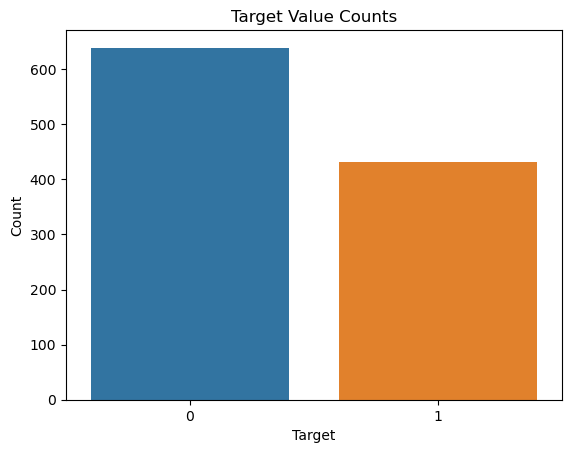

In [18]:
## Calculate value counts 
value_counts = data['Target'].value_counts()

## Create a bar plt
sns.barplot(x=value_counts.index, y =value_counts.values)
plt.xlabel('Target')
plt.ylabel('Count')
plt.title("Target Value Counts")
plt.show()

## Text Preprocessing

Clean and transform the raw data into suitable data for further processing. 

Read this to grasp the text preprocessing ideas from this link: https://www.linkedin.com/pulse/text-preprocessing-natural-language-processing-nlp-germec-phd/ 

1. Tokenization: Break the text into smaller units
2. Normalization: Converting texts into standard or common form like (0 to 1) 
3. Stemming: Reduce the words to their base form by removing the suffixes. So simplify the vocabulary. 
4. Lemmatization: This is the processing of reducing words to their root or base form by removing suffixes. For example, "running" can be stemmed to "run". reduce texts and reduce the vocabulary. 
5. Stopword removal: 
6. Punctuation removal: Remove commas, periods, question marks, or other punctuations from your text. 
7. Spelling correction: Correct spelling errors or typos. 

In [19]:
## Create a local directory for NLTK data 
import os 
nltk_data_path = os.path.expanduser('~/nltk_data')
if not os.path.exists(nltk_data_path):
    os.makedirs(nltk_data_path)

In [20]:
## Download the necessary NLTK resources to the local directory 
nltk.download("stopwords", download_dir=nltk_data_path)
nltk.download("punkt", download_dir=nltk_data_path)
nltk.download("wordnert", download_dir=nltk_data_path)
nltk.download("averaged_perceptron_tagger", download_dir=nltk_data_path)

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\tadnan/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to C:\Users\tadnan/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Error loading wordnert: Package 'wordnert' not found in
[nltk_data]     index
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\tadnan/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [21]:
## Set NLTK data path to the local path directory 
nltk.data.path.append(nltk_data_path)

## Convert to lowercase, strip and remove the punctions 

In [22]:
# Define your preprocessing functions
def preprocess(text):
    text = text.lower()
    text = text.strip()
    text = re.compile('<.*?>').sub('', text)
    text = re.compile('[%s]' % re.escape(string.punctuation)).sub(' ', text)
    text = re.sub('\s+', ' ', text)
    text = re.sub(r'\[[0-9]*\]', ' ', text)
    text = re.sub(r'[^\w\s]', '', text)
    text = re.sub(r'\d', ' ', text)
    text = re.sub(r'\s+', ' ', text)
    return text

## STOPWORD REMOVAL

In [23]:
def stopword(string):
    stop_words = set(stopwords.words('english'))
    return ' '.join([word for word in string.split() if word not in stop_words])

## Lemimatization 

In [24]:
# Initialize the lemmatizer
wl = WordNetLemmatizer()

In [25]:
# This is a helper function to map NTLK position tags
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN

In [26]:
# Tokenize the sentence and lemmatize
def lemmatizer(string):
    word_pos_tags = nltk.pos_tag(word_tokenize(string))  # Get position tags
    a = [wl.lemmatize(tag[0], get_wordnet_pos(tag[1])) for idx, tag in enumerate(word_pos_tags)]  # Map the position tag and lemmatize the word/token
    return " ".join(a)

## Final Preprocessing 

In [27]:
def finalpreprocess(string):
    if isinstance(string, str) and string.strip():  # Check if the input is a non-empty string
        return lemmatizer(stopword(preprocess(string)))
    else:
        return ""  # Return an empty string if the input is not valid

def apply_preprocessing(row):
    try:
        return finalpreprocess(row)
    except Exception as e:
        print(f"Error processing row: {row}")
        print(f"Exception: {e}")
        return ""

In [28]:
# Apply the preprocessing function to the 'Abstract' column
data['Clean_Text_Abstract'] = data['Abstract'].apply(lambda x: apply_preprocessing(x))

C:\Users\tadnan\AppData\Local\Temp\ipykernel_15080\3972691136.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Clean_Text_Abstract'] = data['Abstract'].apply(lambda x: apply_preprocessing(x))


In [29]:
## Get the index of the "Abstract column"
data.columns.get_loc('Abstract')

0

In [30]:
# Create the new column order with 'clean_text' moved to the first position
new_order = ['Clean_Text_Abstract'] + [col for col in data.columns if col != 'Clean_Text_Abstract']

# Reindex the dataframe with the new column order
data = data.reindex(columns=new_order)

## Now drop your 'Abstract' 
data.drop(['Abstract'], axis=1, inplace=True)

data.head(5)

,Clean_Text_Abstract,Target
0,common perception transportation experience people disability improve dramatically since pass american disability act ada though much progress make many aspect current transportation system still limit people disability travel safely efficiently moreover transportation plan design effort consistently lack representation people disability research seek address disconnect via semi structure interview stakeholder self identify disability ii government official whose work intersect supply infrastructure regulate ada interviewee reside work denver region colorado one objective understand attribute transportation infrastructure affect daily mobility people disability second comprehend program management transportation asset affect navigation people disability thematic content analysis interview corpus reveal challenge face people disability hard infrastructure issue program management transportation facility together act diminish quality mobility option people disability work create transportation network universally accessible critical planner engineer work people disability consider design need individual different type disability national academy science transportation research board,1
1,canadian city make significant investment cycle infrastructure support uptake active transportation spatial access supportive infrastructure important equity question lack access safe infrastructure cycling may limit option use bicycle meet transportation need access employment educational social essential service well may achieve physical mental health benefit possible physical activity aim measure spatial access cycling infrastructure canadian city provide broad national understanding inequitable access cycling infrastructure equity deserve population child senior recent immigrant visible minority people low incomes accordingly used national dataset cycling infrastructure bics summarize quantity cycling infrastructure dissemination area canada census data estimate association area level sociodemographic characteristic access cycling infrastructure unadjusted association equity deserve group e recent immigrant people low incomes good access cycling infrastructure pearson coefficient highlight variation equity cycling infrastructure across city overall access equitable across equity deserve group large city compare mid size small city adjust covariates related urban form mode share access cycle infrastructure high area senior recent immigrant visible minority people low income low area child importantly still substantial number people equity deserve group live area low level cycle infrastructure example million child age child million old adult million visible minority million people low income live dissemination area lowest level cycling infrastructure result highlight need understand population stand gain cycling infrastructure investment population leave behind methodology represent useful tool information transport policy initiative advance bicycle equity national scale author,0
2,problem research strategy finding access disaster resource food pose plan problem affect million people year understand disaster disrupt alter food access initial step recovery process provide new evidence inform food system disaster plan research take supply side focus explore result survey food retailer hurricane harvey three texas county survey collect information disaster affect store property people product length time store close reduced hour stop sell fresh food item find focus store closure property damage would underestimate number day resident limited fresh food access nearly week store low income community chronically low access supermarket food desert close long store potentially compound pre exist inequality plan equitable food supply disaster planner embrace dimension access encourage retailer mitigation ass type retailer distribution within community takeaway practice practice planner aspire ensure equitable access resour

In [31]:
type(data)

pandas.core.frame.DataFrame

In [32]:
data.isnull().any()

Clean_Text_Abstract    False
Target                 False
dtype: bool

## Read this link: https://medium.com/@claude.feldges/text-classification-with-tf-idf-lstm-bert-a-quantitative-comparison-b8409b556cb3

### Source : https://www.sabrepc.com/blog/Deep-Learning-and-AI/text-classification-with-bert 

In [33]:
import torch
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertModel
import torch.nn as nn
from torch.optim import AdamW
from tqdm import tqdm

## Create Data

In [34]:
def load_file(df):
    texts = df['Clean_Text_Abstract']
    labels = df['Target']
    return texts, labels 

In [35]:
texts, labels  = load_file(data)

In [36]:
texts.shape

(1071,)

In [37]:
labels.shape

(1071,)

## Train Test Split 

In [38]:
train_texts, val_texts, train_labels, val_labels = train_test_split(texts, labels, test_size=0.2, random_state=42)

Your training data should be in a json format

In [39]:
train_texts

1010                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    

# Train GPT Model

#### Step 1:Adjust the load_file function to output JSON files

In [43]:
import json
def load_file(df):
    texts = df['Clean_Text_Abstract']
    labels = df['Target']
    return texts, labels 

texts, labels  = load_file(data)
train_texts, val_texts, train_labels, val_labels = train_test_split(texts, labels, test_size=0.2, random_state=42)

def save_to_json(filename, texts, labels):
    data = [{"text": text, "label": label} for text, label in zip(texts, labels)]
    with open(filename, 'w') as f:
        json.dump(data, f, indent=4)

save_to_json('train_data.json', train_texts, train_labels)
save_to_json('val_data.json', val_texts, val_labels)

print("Training and validation data saved to JSON files.")

Training and validation data saved to JSON files.


#### Train the GPT-3 model using OpenAI's API

In [44]:
import openai
import json

openai.api_key = "sk-proj-8GAjHiMNtFdyWp0MRP9cT3BlbkFJvdVbwh9v5z1oIx8MOAkD"


def train_gpt3(training_data_file):
    with open(training_data_file, 'r') as file:
        training_data = json.load(file)

    # Prepare the data in the format required by OpenAI API
    training_prompts = [{"prompt": item['text'], "completion": str(item['label'])} for item in training_data]

    # Note: GPT-3 does not support custom training directly. 
    # OpenAI provides fine-tuning for GPT-3 via their API, and it's a different process.
    # This is a placeholder for the fine-tuning process.
    
    # Fine-tuning GPT-3 is a paid service, and the exact implementation will depend on your specific requirements.
    # Refer to OpenAI's documentation for detailed instructions.

    print("GPT-3 model trained.")

train_gpt3('train_data.json')


GPT-3 model trained.


#### Load the trained model to make predictions on your validation data

In [45]:
def get_gpt3_predictions(validation_data_file):
    with open(validation_data_file, 'r') as file:
        validation_data = json.load(file)

    predictions = []
    for item in validation_data:
        response = openai.Completion.create(
            model="text-davinci-003", # Use the appropriate model name
            prompt=item['text'],
            max_tokens=1  # As you need a binary classification output
        )
        predicted_label = response.choices[0].text.strip()
        predictions.append({
            "Clean_Text_Abstract": item['text'],
            "Predicted_Target": int(predicted_label)
        })

    return predictions

predictions = get_gpt3_predictions('val_data.json')


InvalidRequestError: The model `text-davinci-003` has been deprecated, learn more here: https://platform.openai.com/docs/deprecations